In [1]:
pip install lightgbm catboost

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [18]:
# Install required libraries
!pip install pandas numpy scikit-learn xgboost lightgbm catboost imbalanced-learn matplotlib

# Imports
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, StackingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, precision_recall_curve, auc, roc_curve
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings('ignore')



[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [20]:
# Step 1: Load dataset from Hugging Face
from datasets import load_dataset
import pandas as pd

# Load dataset (change split name if not 'train')
ds = load_dataset("honicky/hdfs-logs-encoded-blocks")
df = ds["train"].to_pandas()

# Inspect dataset
print("Dataset Loaded...")
print("Shape:", df.shape)
print("Columns:", df.columns.tolist())
print(df.head())


Dataset Loaded...
Shape: (460048, 5)
Columns: ['event_encoded', 'tokenized_block', 'block_id', 'label', '__index_level_0__']
                                       event_encoded  \
0  <|sep|>0 /10.251.67.211:54457 /10.251.67.211:5...   
1  <|sep|>6 <|sep|>0 /10.251.106.37:36707 /10.251...   
2  <|sep|>6 <|sep|>0 /10.251.121.224:40809 /10.25...   
3  <|sep|>0 /10.251.123.20:56258 /10.251.123.20:5...   
4  <|sep|>6 <|sep|>0 /10.251.107.242:55242 /10.25...   

                                     tokenized_block  \
0  [50277, 17, 1227, 740, 15, 21451, 15, 2251, 15...   
1  [50277, 23, 209, 50277, 17, 1227, 740, 15, 214...   
2  [50277, 23, 209, 50277, 17, 1227, 740, 15, 214...   
3  [50277, 17, 1227, 740, 15, 21451, 15, 10683, 1...   
4  [50277, 23, 209, 50277, 17, 1227, 740, 15, 214...   

                   block_id   label  __index_level_0__  
0  blk_-4040947678439826686  Normal             257494  
1   blk_1870752360007129176  Normal              49365  
2  blk_-1999301527305082358  N

In [21]:
from sklearn.model_selection import train_test_split
from collections import Counter

target_col = df.columns[-1]
X = df.drop(columns=[target_col])
y = df[target_col]

counts = y.value_counts()
minority_class = counts.idxmin()
min_count = counts.min()

# Define a minimum number of samples needed for splitting
min_samples_needed = 2

if min_count >= min_samples_needed:
    # Best case: stratify safely
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42, stratify=y
    )
else:
    # Edge case: too few minority samples in the whole dataset
    # Put all minority samples in TEST to keep evaluation meaningful
    minority_idx = y[y == minority_class].index
    majority_idx = y[y != minority_class].index

    # Build test set: the single minority + enough majority to reach 20% (or all majority if not enough)
    test_size_abs = int(0.2 * len(df))
    majority_needed = max(test_size_abs - len(minority_idx), 0)
    
    # Ensure we don't sample more majority indices than available
    n_majority_to_sample = min(majority_needed, len(majority_idx))
    
    test_majority = majority_idx.to_series().sample(
        n=n_majority_to_sample,
        random_state=42,
        replace=False
    )
    
    # Corrected line: convert test_majority Series to Index before appending
    test_idx = pd.Index(minority_idx).append(pd.Index(test_majority.index))
    
    train_idx = X.index.difference(test_idx)

    X_train, y_train = X.loc[train_idx], y.loc[train_idx]
    X_test,  y_test  = X.loc[test_idx],  y.loc[test_idx]


print("Train shape:", X_train.shape, " Test shape:", X_test.shape)
print("Train distribution:", Counter(y_train))
print("Test distribution:", Counter(y_test))

Train shape: (368039, 4)  Test shape: (92009, 4)
Train distribution: Counter({257494: 1, 49365: 1, 7319: 1, 295080: 1, 64733: 1, 401427: 1, 175334: 1, 176981: 1, 171198: 1, 308768: 1, 35898: 1, 350644: 1, 433767: 1, 417463: 1, 219927: 1, 9959: 1, 258359: 1, 476218: 1, 307961: 1, 573742: 1, 80963: 1, 532579: 1, 29413: 1, 332236: 1, 168779: 1, 507755: 1, 445544: 1, 146988: 1, 492824: 1, 451717: 1, 446302: 1, 350615: 1, 251382: 1, 122601: 1, 236347: 1, 377044: 1, 265890: 1, 219026: 1, 382355: 1, 320703: 1, 470235: 1, 372027: 1, 546273: 1, 561016: 1, 463022: 1, 105420: 1, 302543: 1, 367558: 1, 261987: 1, 317434: 1, 324971: 1, 198691: 1, 457198: 1, 464621: 1, 326680: 1, 97992: 1, 2964: 1, 324309: 1, 357581: 1, 6385: 1, 375229: 1, 406880: 1, 3947: 1, 250793: 1, 100211: 1, 85500: 1, 65880: 1, 400228: 1, 320868: 1, 167634: 1, 31646: 1, 46652: 1, 462545: 1, 317993: 1, 312796: 1, 551456: 1, 331581: 1, 201609: 1, 166240: 1, 238393: 1, 317842: 1, 395370: 1, 471495: 1, 159185: 1, 571187: 1, 42618: 

In [24]:
# SEGMENT 3 — Handle Class Imbalance (SMOTE on training set only)

from imblearn.over_sampling import SMOTE

# Check original class distribution in train set
print("\nBefore SMOTE — Train class distribution:", Counter(y_train))

# Get the minimum number of samples in any class
min_samples = min(Counter(y_train).values())

# Apply SMOTE only if there are at least 2 samples in the minority class
if min_samples > 1:
    # Apply SMOTE only on training set
    smote = SMOTE(random_state=42, k_neighbors=min(5, min_samples - 1))
    X_train_res, y_train_res = smote.fit_resample(X_train, y_train)

    # Check new distribution
    print("After SMOTE  — Train class distribution:", Counter(y_train_res))

    # Sizes after resampling
    print("Resampled train shape:", X_train_res.shape)
else:
    print(f"Skipping SMOTE: Minimum class size is {min_samples}, which is less than 2.")
    X_train_res, y_train_res = X_train, y_train # Keep original data if SMOTE is skipped


Before SMOTE — Train class distribution: Counter({257494: 1, 49365: 1, 7319: 1, 295080: 1, 64733: 1, 401427: 1, 175334: 1, 176981: 1, 171198: 1, 308768: 1, 35898: 1, 350644: 1, 433767: 1, 417463: 1, 219927: 1, 9959: 1, 258359: 1, 476218: 1, 307961: 1, 573742: 1, 80963: 1, 532579: 1, 29413: 1, 332236: 1, 168779: 1, 507755: 1, 445544: 1, 146988: 1, 492824: 1, 451717: 1, 446302: 1, 350615: 1, 251382: 1, 122601: 1, 236347: 1, 377044: 1, 265890: 1, 219026: 1, 382355: 1, 320703: 1, 470235: 1, 372027: 1, 546273: 1, 561016: 1, 463022: 1, 105420: 1, 302543: 1, 367558: 1, 261987: 1, 317434: 1, 324971: 1, 198691: 1, 457198: 1, 464621: 1, 326680: 1, 97992: 1, 2964: 1, 324309: 1, 357581: 1, 6385: 1, 375229: 1, 406880: 1, 3947: 1, 250793: 1, 100211: 1, 85500: 1, 65880: 1, 400228: 1, 320868: 1, 167634: 1, 31646: 1, 46652: 1, 462545: 1, 317993: 1, 312796: 1, 551456: 1, 331581: 1, 201609: 1, 166240: 1, 238393: 1, 317842: 1, 395370: 1, 471495: 1, 159185: 1, 571187: 1, 42618: 1, 16141: 1, 351597: 1, 466

In [ ]:
# =========================
# SEGMENT 4 — Encode Text + Train Models
# =========================

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, precision_recall_curve, auc
import numpy as np

# Convert all feature columns into a single string per row
X_train_str = X_train.astype(str).agg(" ".join, axis=1)
X_test_str = X_test.astype(str).agg(" ".join, axis=1)

# TF-IDF vectorization
vectorizer = TfidfVectorizer(max_features=5000)  # limit features for speed
X_train_vec = vectorizer.fit_transform(X_train_str)
X_test_vec = vectorizer.transform(X_test_str)

# Models with imbalance handling
models = {
    "RandomForest": RandomForestClassifier(
        n_estimators=300,
        max_depth=None,
        class_weight="balanced",
        random_state=42
    ),
    "XGBoost": XGBClassifier(
        scale_pos_weight=(len(y_train) - sum(y_train)) / max(sum(y_train), 1),
        use_label_encoder=False,
        eval_metric="logloss",
        n_estimators=500,
        max_depth=6,
        learning_rate=0.05,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )
}

results = {}

for name, model in models.items():
    model.fit(X_train_vec, y_train)

    # Predict probabilities
    y_prob = model.predict_proba(X_test_vec)[:, 1]

    # Tune probability threshold for best F1
    thresholds = np.linspace(0, 1, 101)
    f1_scores = [
        f1_score(y_test, (y_prob >= t).astype(int), zero_division=0) for t in thresholds
    ]
    best_thresh = thresholds[int(np.argmax(f1_scores))]
    y_pred = (y_prob >= best_thresh).astype(int)

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, zero_division=0)
    roc = roc_auc_score(y_test, y_prob) if len(np.unique(y_test)) > 1 else np.nan
    precision, recall, _ = precision_recall_curve(y_test, y_prob)
    pr_auc = auc(recall, precision)

    results[name] = {
        "Best Threshold": best_thresh,
        "Accuracy": acc,
        "F1 Score": f1,
        "ROC AUC": roc,
        "PR AUC": pr_auc
    }

# Show results
for model_name, metrics in results.items():
    print(f"\n=== {model_name} ===")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}" if isinstance(value, (int, float)) else f"{metric}: {value}")


In [1]:
# =========================
# SEGMENT 1 — Load Dataset
# =========================
from datasets import load_dataset
import pandas as pd
from collections import Counter

print("Loading dataset from Hugging Face...")
ds = load_dataset("honicky/hdfs-logs-encoded-blocks")
df = ds["train"].to_pandas()
print("Dataset loaded with shape:", df.shape)
print(df.head())

# =========================
# SEGMENT 2 — Inspect & Clean Data
# =========================
print("\nChecking for missing values...")
print(df.isnull().sum())
df = df.dropna()
print("After dropping NaNs, shape:", df.shape)

# Ensure target column is last
target_col = df.columns[-1]
print("Target column:", target_col)

# =========================
# SEGMENT 3 — Safe Train/Test Split (Handles rare classes)
# =========================
from sklearn.model_selection import train_test_split

X = df.drop(columns=[target_col])
y = df[target_col]

counts = y.value_counts()
minority_class = counts.idxmin()
min_count = counts.min()
min_samples_needed = 2

if min_count >= min_samples_needed:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42, stratify=y
    )
else:
    minority_idx = y[y == minority_class].index
    majority_idx = y[y != minority_class].index

    test_size_abs = int(0.2 * len(df))
    majority_needed = max(test_size_abs - len(minority_idx), 0)
    n_majority_to_sample = min(majority_needed, len(majority_idx))

    test_majority = majority_idx.to_series().sample(
        n=n_majority_to_sample,
        random_state=42,
        replace=False
    )
    
    test_idx = pd.Index(minority_idx).append(pd.Index(test_majority.index))
    train_idx = X.index.difference(test_idx)

    X_train, y_train = X.loc[train_idx], y.loc[train_idx]
    X_test, y_test  = X.loc[test_idx],  y.loc[test_idx]

print("\nTrain shape:", X_train.shape, "Test shape:", X_test.shape)
print("Train distribution:", Counter(y_train))
print("Test distribution:", Counter(y_test))

# =========================
# SEGMENT 4 — Handle Imbalance (Safe SMOTE)
# =========================
from imblearn.over_sampling import SMOTE

print("\nBefore SMOTE — Train class distribution:", Counter(y_train))

minority_count_train = min(Counter(y_train).values())
if minority_count_train > 1:
    smote = SMOTE(random_state=42, k_neighbors=min(5, minority_count_train - 1))
    X_train_res, y_train_res = smote.fit_resample(X_train, y_train)
else:
    X_train_res, y_train_res = X_train, y_train
    print("Skipping SMOTE — only one sample in minority class")

print("After SMOTE  — Train class distribution:", Counter(y_train_res))

# =========================
# SEGMENT 5 — Text Vectorization
# =========================
from sklearn.feature_extraction.text import TfidfVectorizer

X_train_str = X_train_res.astype(str).agg(" ".join, axis=1)
X_test_str = X_test.astype(str).agg(" ".join, axis=1)

vectorizer = TfidfVectorizer(max_features=5000)
X_train_vec = vectorizer.fit_transform(X_train_str)
X_test_vec = vectorizer.transform(X_test_str)

print("TF-IDF vocab size:", len(vectorizer.vocabulary_))

# =========================
# SEGMENT 6 — Define Models
# =========================
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

models = {
    "RandomForest": RandomForestClassifier(
        n_estimators=300,
        max_depth=None,
        class_weight="balanced",
        random_state=42
    ),
    "XGBoost": XGBClassifier(
        scale_pos_weight=(len(y_train_res) - sum(y_train_res)) / max(sum(y_train_res), 1),
        use_label_encoder=False,
        eval_metric="logloss",
        n_estimators=500,
        max_depth=6,
        learning_rate=0.05,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )
}

# =========================
# SEGMENT 7 — Train & Evaluate
# =========================
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, precision_recall_curve, auc
import numpy as np

results = {}

for name, model in models.items():
    model.fit(X_train_vec, y_train_res)
    y_prob = model.predict_proba(X_test_vec)[:, 1]

    thresholds = np.linspace(0, 1, 101)
    f1_scores = [f1_score(y_test, (y_prob >= t).astype(int), zero_division=0) for t in thresholds]
    best_thresh = thresholds[int(np.argmax(f1_scores))]
    y_pred = (y_prob >= best_thresh).astype(int)

    acc = accuracy_score(y_test, y_pred)
    f1_val = f1_score(y_test, y_pred, zero_division=0)
    roc = roc_auc_score(y_test, y_prob) if len(np.unique(y_test)) > 1 else np.nan
    precision, recall, _ = precision_recall_curve(y_test, y_prob)
    pr_auc = auc(recall, precision)

    results[name] = {
        "Best Threshold": best_thresh,
        "Accuracy": acc,
        "F1 Score": f1_val,
        "ROC AUC": roc,
        "PR AUC": pr_auc
    }

for model_name, metrics in results.items():
    print(f"\n=== {model_name} ===")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}" if isinstance(value, (int, float)) else f"{metric}: {value}")

# =========================
# SEGMENT 8 — Plot ROC & PR Curves
# =========================
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
for name, model in models.items():
    y_prob = model.predict_proba(X_test_vec)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=name)
plt.plot([0,1],[0,1], 'k--')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()

plt.subplot(1,2,2)
for name, model in models.items():
    y_prob = model.predict_proba(X_test_vec)[:, 1]
    precision, recall, _ = precision_recall_curve(y_test, y_prob)
    plt.plot(recall, precision, label=name)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve")
plt.legend()
plt.show()

# =========================
# SEGMENT 9 — Feature Importance (RandomForest Example)
# =========================
import numpy as np

rf_model = models["RandomForest"]
feature_names = vectorizer.get_feature_names_out()
importances = rf_model.feature_importances_
indices = np.argsort(importances)[-20:][::-1]

print("\nTop 20 Important Features (RandomForest):")
for i in indices:
    print(f"{feature_names[i]}: {importances[i]:.4f}")

# =========================
# SEGMENT 10 — Save Models & Vectorizer
# =========================
import joblib

joblib.dump(vectorizer, "tfidf_vectorizer.pkl")
for name, model in models.items():
    joblib.dump(model, f"{name}_model.pkl")
print("\nModels and vectorizer saved.")


c:\Users\ASUS\miniconda3\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading dataset from Hugging Face...
Dataset loaded with shape: (460048, 5)
                                       event_encoded  \
0  <|sep|>0 /10.251.67.211:54457 /10.251.67.211:5...   
1  <|sep|>6 <|sep|>0 /10.251.106.37:36707 /10.251...   
2  <|sep|>6 <|sep|>0 /10.251.121.224:40809 /10.25...   
3  <|sep|>0 /10.251.123.20:56258 /10.251.123.20:5...   
4  <|sep|>6 <|sep|>0 /10.251.107.242:55242 /10.25...   

                                     tokenized_block  \
0  [50277, 17, 1227, 740, 15, 21451, 15, 2251, 15...   
1  [50277, 23, 209, 50277, 17, 1227, 740, 15, 214...   
2  [50277, 23, 209, 50277, 17, 1227, 740, 15, 214...   
3  [50277, 17, 1227, 740, 15, 21451, 15, 10683, 1...   
4  [50277, 23, 209, 50277, 17, 1227, 740, 15, 214...   

                   block_id   label  __index_level_0__  
0  blk_-4040947678439826686  Normal             257494  
1   blk_1870752360007129176  Normal              49365  
2  blk_-1999301527305082358  Normal               7319  
3  blk_-23225207987457

KeyboardInterrupt: 

Loading dataset from Hugging Face...
Dataset loaded with shape: (460048, 5)

Checking for missing values...
After dropping NaNs, shape: (460048, 5)

Train shape: (368038, 4) Test shape: (92010, 4)

Engineering numerical features...
Vectorizing text features with TF-IDF...
Combining numerical and text features into a hybrid set...
Final training data shape: (368038, 5002)

Tuning XGBoost hyperparameters... (This may take some time but will be memory-safe)
Fitting 3 folds for each of 10 candidates, totalling 30 fits


c:\Users\ASUS\miniconda3\Lib\site-packages\xgboost\training.py:183: UserWarning: [05:29:25] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\ASUS\miniconda3\Lib\site-packages\xgboost\training.py:183: UserWarning: [05:53:06] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\ASUS\miniconda3\Lib\site-packages\xgboost\training.py:183: UserWarning: [09:15:46] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\ASUS\miniconda3\Lib\site-packages\xgboost\training.py:183: UserWarning: [09:19:18] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtr


Best hyperparameters found: {'subsample': 0.8, 'n_estimators': 700, 'max_depth': 6, 'learning_rate': 0.1, 'colsample_bytree': 0.8}

Evaluating the tuned model on the test set...

=== Tuned XGBoost Performance ===
Best Threshold: 0.9276
Accuracy: 0.9998
F1 Score: 0.9961
ROC AUC: 1.0000
PR AUC: 0.9997

Generating plots...


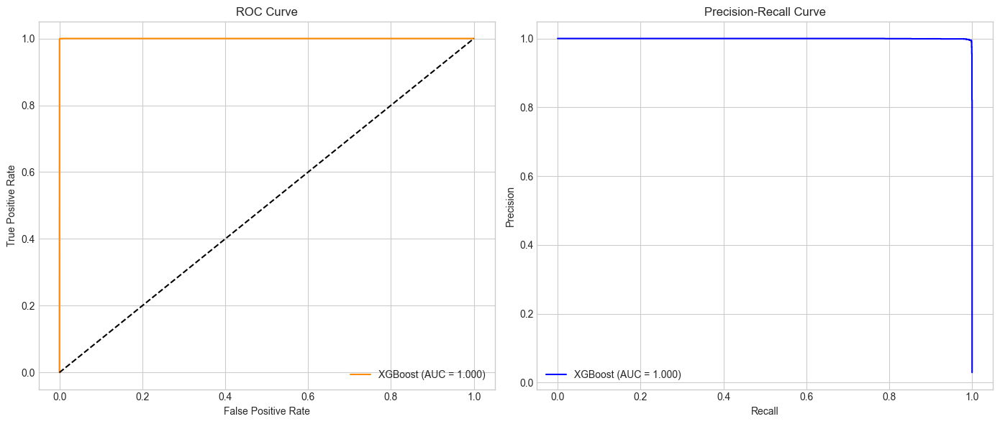

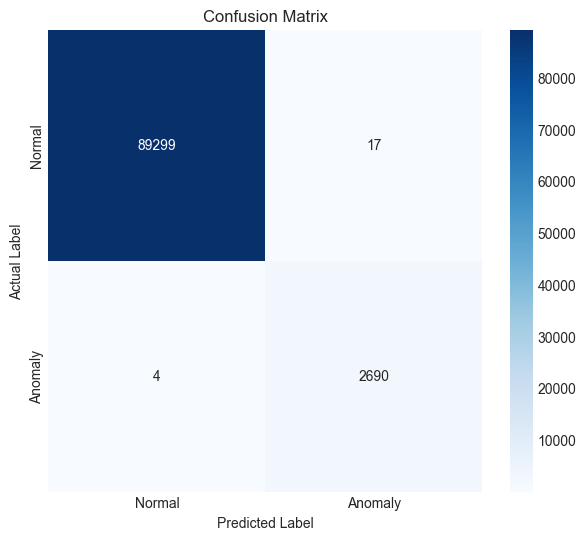

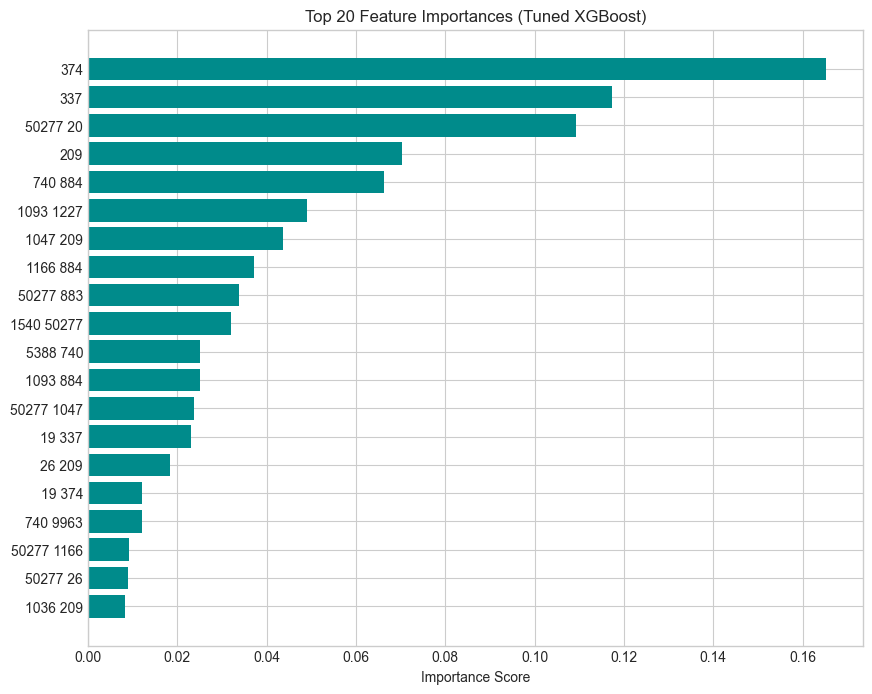


Saving final model and vectorizer...
Models and vectorizer saved successfully.


In [ ]:

## SEGMENT 1 — IMPORTS AND SETUP

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import joblib
from collections import Counter

# Data Loading
from datasets import load_dataset

# Preprocessing and Feature Engineering
from sklearn.model_selection import train_test_split

from sklearn.feature_extraction.text import TfidfVectorizer
from scipy.sparse import hstack

# Modeling and Tuning
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV

# Evaluation
from sklearn.metrics import (accuracy_score, f1_score, roc_auc_score,
                             precision_recall_curve, roc_curve, auc,
                             confusion_matrix)
import seaborn as sns


## SEGMENT 2 — LOAD AND PREPARE DATA
print("Loading dataset from Hugging Face...")
ds = load_dataset("honicky/hdfs-logs-encoded-blocks")
df = ds["train"].to_pandas()
print("Dataset loaded with shape:", df.shape)

print("\nChecking for missing values...")
df = df.dropna(subset=['block_id', 'tokenized_block', 'label'])
print("After dropping NaNs, shape:", df.shape)

df['label'] = df['label'].map({'Normal': 0, 'Anomaly': 1})
X = df.drop(columns=['label'])
y = df['label']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)
print("\nTrain shape:", X_train.shape, "Test shape:", X_test.shape)


## SEGMENT 3 — HYBRID FEATURE ENGINEERING
print("\nEngineering numerical features...")
X_train_num = X_train.copy()
X_test_num = X_test.copy()

X_train_num['numeric_id'] = X_train_num['block_id'].str.findall(r'-?\d+').str[0].astype(float)
X_test_num['numeric_id'] = X_test_num['block_id'].str.findall(r'-?\d+').str[0].astype(float)
X_train_num['seq_length'] = X_train_num['tokenized_block'].astype(str).str.split().apply(len)
X_test_num['seq_length'] = X_test_num['tokenized_block'].astype(str).str.split().apply(len)

numerical_features = ['numeric_id', 'seq_length']
X_train_numerical = X_train_num[numerical_features].fillna(0)
X_test_numerical = X_test_num[numerical_features].fillna(0)

print("Vectorizing text features with TF-IDF...")
X_train_text = X_train['tokenized_block'].astype(str)
X_test_text = X_test['tokenized_block'].astype(str)

vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1, 2))
X_train_vec = vectorizer.fit_transform(X_train_text)
X_test_vec = vectorizer.transform(X_test_text)

print("Combining numerical and text features into a hybrid set...")
X_train_final = hstack([X_train_vec, X_train_numerical]).tocsr()
X_test_final = hstack([X_test_vec, X_test_numerical]).tocsr()
print("Final training data shape:", X_train_final.shape)


## SEGMENT 4 — HYPERPARAMETER TUNING (Memory-Efficient)
param_dist = {
    'n_estimators': [300, 500, 700],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [6, 8, 10],
    'subsample': [0.7, 0.8],
    'colsample_bytree': [0.7, 0.8]
}

# Calculate scale_pos_weight on the ORIGINAL training data
imbalance_ratio = (y_train == 0).sum() / (y_train == 1).sum()

xgb_model = XGBClassifier(
    scale_pos_weight=imbalance_ratio,
    use_label_encoder=False,
    eval_metric="logloss",
    random_state=42
)

print("\nTuning XGBoost hyperparameters... (This may take some time but will be memory-safe)")
# Set n_jobs=1 to prevent memory overload from parallel processing.
random_search = RandomizedSearchCV(
    xgb_model,
    param_distributions=param_dist,
    n_iter=10,
    cv=3,
    scoring='f1',
    random_state=42,
    verbose=1,
    n_jobs=1  # Use 1 core to ensure it runs without memory errors
)

random_search.fit(X_train_final, y_train)

print("\nBest hyperparameters found:", random_search.best_params_)
best_model = random_search.best_estimator_


## SEGMENT 5 — FINAL EVALUATION
print("\nEvaluating the tuned model on the test set...")
y_prob = best_model.predict_proba(X_test_final)[:, 1]

precision_curve, recall_curve, thresholds = precision_recall_curve(y_test, y_prob)
f1_scores = [f1_score(y_test, (y_prob >= t).astype(int), zero_division=0) for t in thresholds]
best_thresh = thresholds[np.argmax(f1_scores)]
y_pred = (y_prob >= best_thresh).astype(int)

acc = accuracy_score(y_test, y_pred)
f1_val = f1_score(y_test, y_pred, zero_division=0)
roc_auc = roc_auc_score(y_test, y_prob)
pr_auc = auc(recall_curve, precision_curve)

print("\n=== Tuned XGBoost Performance ===")
print(f"Best Threshold: {best_thresh:.4f}")
print(f"Accuracy: {acc:.4f}")
print(f"F1 Score: {f1_val:.4f}")
print(f"ROC AUC: {roc_auc:.4f}")
print(f"PR AUC: {pr_auc:.4f}")


## SEGMENT 6 & 7 — PLOTTING AND SAVING
print("\nGenerating plots...")
plt.style.use('seaborn-v0_8-whitegrid')

# --- Plot ROC and PR Curves ---
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1); fpr, tpr, _ = roc_curve(y_test, y_prob); plt.plot(fpr, tpr, label=f'XGBoost (AUC = {roc_auc:.3f})', color='darkorange'); plt.plot([0, 1], [0, 1], 'k--'); plt.xlabel("False Positive Rate"); plt.ylabel("True Positive Rate"); plt.title("ROC Curve"); plt.legend()
plt.subplot(1, 2, 2); plt.plot(recall_curve, precision_curve, label=f'XGBoost (AUC = {pr_auc:.3f})', color='blue'); plt.xlabel("Recall"); plt.ylabel("Precision"); plt.title("Precision-Recall Curve"); plt.legend()
plt.tight_layout(); plt.show()

# --- Plot Confusion Matrix ---
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(7, 6)); sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Normal', 'Anomaly'], yticklabels=['Normal', 'Anomaly']); plt.title('Confusion Matrix'); plt.ylabel('Actual Label'); plt.xlabel('Predicted Label'); plt.show()

# --- Plot Feature Importance ---
feature_names_tfidf = vectorizer.get_feature_names_out()
final_feature_names = np.concatenate([feature_names_tfidf, numerical_features])
importances = best_model.feature_importances_
indices = np.argsort(importances)[-20:][::-1]
plt.figure(figsize=(10, 8)); plt.title("Top 20 Feature Importances (Tuned XGBoost)"); plt.barh(range(len(indices)), importances[indices], color='darkcyan', align='center'); plt.yticks(range(len(indices)), [final_feature_names[i] for i in indices]); plt.xlabel("Importance Score"); plt.gca().invert_yaxis(); plt.show()

# --- Save Final Model ---
print("\nSaving final model and vectorizer...")
joblib.dump(vectorizer, "tfidf_vectorizer_final.pkl")
joblib.dump(best_model, "xgboost_model_final.pkl")
print("Models and vectorizer saved successfully.")